# DECO

### Packages

In [1]:
import torch
import os
import sys
import numpy as np
import cv2
from loguru import logger
from PIL import Image
import json
import pandas as pd
import matplotlib.pyplot as plt

import trimesh

deco_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(deco_dir)


# Monkey-patch deprecated attributes for chumpy
np.bool = bool
np.int = int
np.float = float
np.complex = complex
np.object = object
np.str = str
np.unicode = str

from models.deco import DECO

os.environ['PYOPENGL_PLATFORM'] = 'egl'

if torch.cuda.is_available():
    DEVICE = torch.device('cuda')
else:
    DEVICE = torch.device('cpu')
print("Running on:", DEVICE)

ckpt_path = os.path.join(deco_dir, 'checkpoints', 'Release_Checkpoint', 'deco_best.pth')
MODEL_PATH = ckpt_path

def initiate_model(device):
    deco_model = DECO('hrnet', True, device)
    # deco_model = DECO('swin', True, device)

    logger.info(f'Loading weights from {MODEL_PATH}')
    print(device)


    checkpoint = torch.load(MODEL_PATH,  map_location=device, weights_only=False)
    deco_model.load_state_dict(checkpoint['deco'], strict=False)
    deco_model.eval()

    return deco_model

torch.cuda.empty_cache()
deco_model = initiate_model(DEVICE)


def visualize_body_mesh(cont, smpl_path="../data/smpl/smpl_neutral_tpose.ply", mesh_colour=[220, 220, 220, 255], annot_colour=[0, 255, 0, 255]):
    cont_smpl = []
    for indx, i in enumerate(cont):
        if i >= 0.5:
            cont_smpl.append(indx)

    contact_smpl = np.zeros((1, 1, 6890))
    contact_smpl[0][0][cont_smpl] = 1

    body_model_smpl = trimesh.load(smpl_path, process=False)
    for vert in range(body_model_smpl.visual.vertex_colors.shape[0]):
        body_model_smpl.visual.vertex_colors[vert] = mesh_colour
    body_model_smpl.visual.vertex_colors[cont_smpl] = annot_colour
    return body_model_smpl

def contact_prediction(img_src):

    # for img_name in images:
    img = cv2.imread(img_src)
    img = cv2.resize(img, (256, 256), cv2.INTER_CUBIC)
    img = img.transpose(2, 0, 1) / 255.0
    img = img[np.newaxis, :, :, :]
    img = torch.tensor(img, dtype=torch.float32).to(DEVICE)

    cont, scene_mask_pred, part_mask_pred, _ = deco_model(img)
    cont = cont.detach().cpu().numpy().squeeze()
    scene_mask_pred = scene_mask_pred.detach().cpu().numpy().squeeze()
    part_mask_pred = part_mask_pred.detach().cpu().numpy().squeeze()

    body_model_smpl = visualize_body_mesh(cont)


    # Process semantic mask
    scene_mask_max = np.argmax(scene_mask_pred, axis=0).astype(np.uint8)

    # Process part mask
    part_mask_max = np.argmax(part_mask_pred, axis=0).astype(np.uint8)

    return np.flipud(scene_mask_max), np.flipud(part_mask_max), body_model_smpl

2025-06-10 17:13:19.456 | INFO     | utils.hrnet:init_weights:525 - => init weights from normal distribution


Running on: cpu


2025-06-10 17:13:19.641 | WARNING  | utils.hrnet:init_weights:553 - IMPORTANT WARNING!! Please download pre-trained models if you are in TRAINING mode!
2025-06-10 17:13:19.700 | INFO     | utils.hrnet:init_weights:525 - => init weights from normal distribution
2025-06-10 17:13:19.886 | WARNING  | utils.hrnet:init_weights:553 - IMPORTANT WARNING!! Please download pre-trained models if you are in TRAINING mode!
2025-06-10 17:13:19.953 | INFO     | __main__:initiate_model:44 - Loading weights from /Users/fleurdolmans/Downloads/deco-main-2/checkpoints/Release_Checkpoint/deco_best.pth


cpu


# Qualitative Results

## Man on a bench

(-0.5, 639.5, 456.5, -0.5)

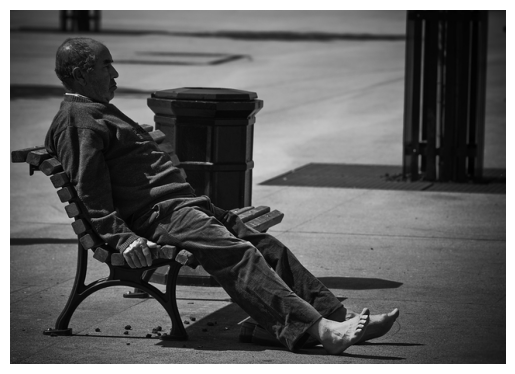

In [2]:
data = np.load('../datasets/Release_Datasets/damon/hot_dca_trainval.npz')
img_src = f"../{data['imgname'][2006]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [3]:
cont = data['contact_label'][2006]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [4]:
mesh = trimesh.load('DecoDINO_out/man_on_bench/pred.obj', mesh_colour=[220, 220, 220, 255])
mesh.show()

### DECO predicted contact

In [5]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()

## Kid on a couch

(-0.5, 239.5, 179.5, -0.5)

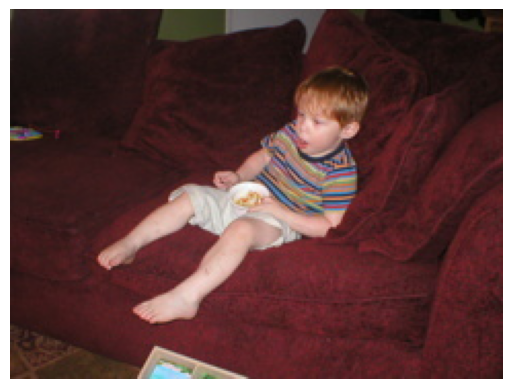

In [6]:
img_src = f"../{data['imgname'][2383]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [7]:
cont = data['contact_label'][2383]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [8]:
mesh = trimesh.load('DecoDINO_out/kid_couch/pred.obj', mesh_colour=[220, 220, 220, 255])
mesh.show()

### DECO predicted contact

In [9]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()

## Kid with a book

(-0.5, 425.5, 639.5, -0.5)

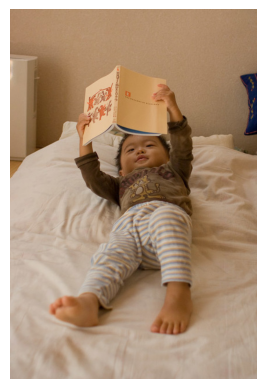

In [35]:
img_src = f"../{data['imgname'][3031]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [36]:
cont = data['contact_label'][3031]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [37]:
mesh = trimesh.load('DecoDINO_out/kid_book/pred.obj', process=False)
mesh.show()   

### DECO predicted contact

In [38]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()

## Man on scooter

(-0.5, 639.5, 423.5, -0.5)

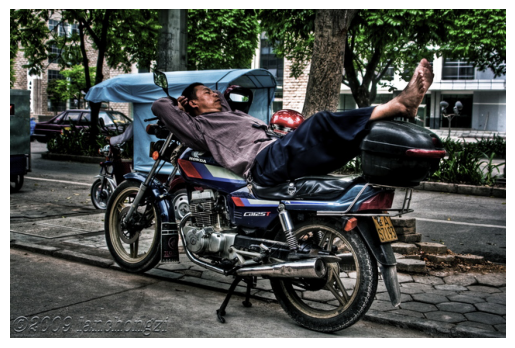

In [39]:
img_src = f"../{data['imgname'][1610]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [40]:
cont = data['contact_label'][1610]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [41]:
mesh = trimesh.load('DecoDINO_out/man_on_scooter/pred.obj', process=False)
mesh.show()   

### DECO predicted contact

In [43]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()


## Man with donut

(-0.5, 639.5, 426.5, -0.5)

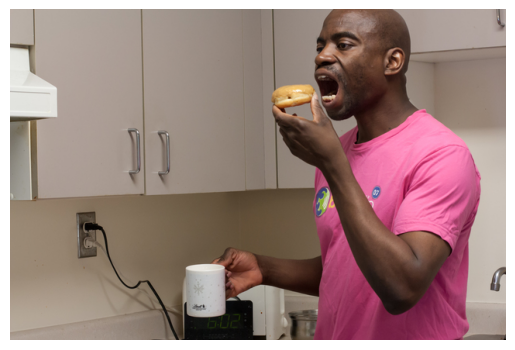

In [44]:
img_src = f"../{data['imgname'][3947]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [45]:
cont = data['contact_label'][3947]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [49]:
mesh = trimesh.load('DecoDINO_out/man_with_donut/pred.obj', process=False)
mesh.show()  

### DECO predicted contact

In [50]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show() 

## Monnik on a bench

(-0.5, 639.5, 458.5, -0.5)

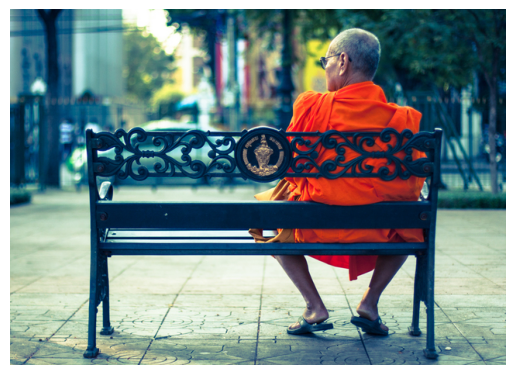

In [51]:
img_src = f"../{data['imgname'][2595]}"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### Ground Truth

In [55]:
cont = data['contact_label'][2595]
body_mesh = visualize_body_mesh(cont, annot_colour=[255, 0, 0, 255])
body_mesh.show()

### DecoDINO predicted contact

In [52]:
mesh = trimesh.load('DecoDINO_out/monnik_on_bench/pred.obj', process=False)
mesh.show() 


### DECO predicted contact

In [54]:

_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()  

## Zombi

(-0.5, 1443.5, 801.5, -0.5)

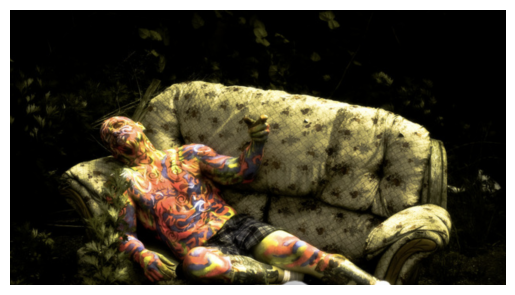

In [56]:
img_src = "/Users/fleurdolmans/Downloads/deco-main-2/Qualitative/DecoDINO_out/zombi/image.png"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### DecoDINO contact prediction

In [57]:
mesh = trimesh.load('DecoDINO_out/zombi/pred.obj', process=False)
mesh.show()   

### DECO contact prediction

In [58]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()

# Scene's without contact

## Jumping

(-0.5, 560.5, 658.5, -0.5)

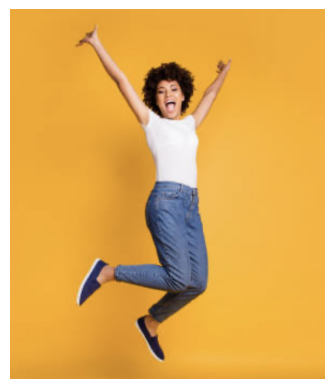

In [28]:
img_src = "DecoDINO_out/jumping/image.jpg"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### DecoDINO contact prediction

In [29]:
mesh = trimesh.load('DecoDINO_out/jumping/pred.obj', process=False)
mesh.show()   

### DECO contact prediction

In [30]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()

## Sea

(-0.5, 2559.5, 1599.5, -0.5)

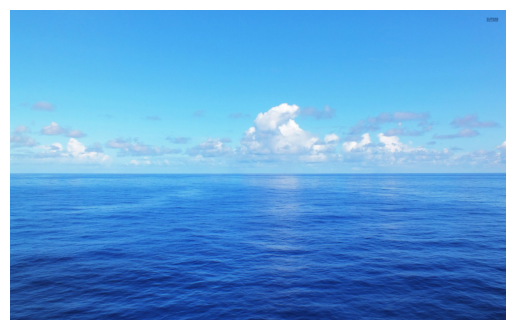

In [31]:
img_src = "DecoDINO_out/sea/image.jpg"
img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')

### DecoDINO contact prediction

In [32]:
mesh = trimesh.load('DecoDINO_out/sea/pred.obj', process=False)
mesh.show()   

### DECO contact prediction

In [33]:
_, _, body_model_smpl = contact_prediction(img_src)
body_model_smpl.show()